In [1]:
# !pip install healpy

In [2]:
# !pip install astropy

In [1]:
import numpy as np
import pandas as pd
import healpy as hp
import matplotlib
from matplotlib import pyplot as plt
from astropy.coordinates import SkyCoord
import astropy.units as u
from astropy.coordinates.matrix_utilities import rotation_matrix
from astropy.coordinates import SkyCoord, CartesianRepresentation
from astropy.wcs import WCS
from astropy.visualization import astropy_mpl_style
from astropy.time import Time
import utility as util

In [2]:
#Initializing all the variables.

NSIDE = 4096
NPIX  = hp.nside2npix(NSIDE)

og_df = pd.read_csv('simple_model_images_files_data.csv')

In [3]:
# og_df.head()

In [4]:
df = og_df[(og_df['POINTING'] == 330)].sort_values(by=['RA1', 'DEC1'])

# Mosaic Wide (38) + Deep (7) Imaging Pattern

### Wide Imaging Pattern

In [5]:
df_38 = util.translate_squares_custom_9x5_38(df)

/Users/saaranshpandey/Documents/Spring 2025/RA/utility.py:992: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  single_pointing["remove"] = 0
/Users/saaranshpandey/Documents/Spring 2025/RA/utility.py:992: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  single_pointing["remove"] = 0
/Users/saaranshpandey/Documents/Spring 2025/RA/utility.py:992: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the

In [6]:
ra_cen_38 = df_38[[f'RA{i}' for i in range(1, 5)]].mean().mean()
dec_cen_38 = df_38[[f'DEC{i}' for i in range(1, 5)]].mean().mean()

print(f"RA: {ra_cen_38}; DEC: {dec_cen_38}")

RA: 9.929758150728558; DEC: -43.989593039552204


### Deep Imaging Pattern

In [7]:
df_7 = util.translate_squares_custom_7(df)

In [8]:
df_7_shifted = util.shift_centers(df_7, ra_cen_38, dec_cen_38)

In [9]:
ra_cen_7 = df_7_shifted[[f'RA{i}' for i in range(1, 5)]].mean().mean()
dec_cen_7 = df_7_shifted[[f'DEC{i}' for i in range(1, 5)]].mean().mean()

print(f"RA: {ra_cen_7}; DEC: {dec_cen_7}")

RA: 9.929758150728556; DEC: -43.989593039552204


### Final pattern

In [10]:
final_df_provisional = pd.concat([df_38, df_7_shifted], ignore_index=True)

In [11]:
ra_cen = final_df_provisional[[f'RA{i}' for i in range(1, 5)]].mean().mean()
dec_cen = final_df_provisional[[f'DEC{i}' for i in range(1, 5)]].mean().mean()

print(f"RA: {ra_cen}; DEC: {dec_cen}")

RA: 9.929758150728558; DEC: -43.989593039552204


In [12]:
final_df = util.recenter_exposure(final_df_provisional)

In [13]:
ra_cen = final_df[[f'RA{i}' for i in range(1, 5)]].mean().mean()
dec_cen = final_df[[f'DEC{i}' for i in range(1, 5)]].mean().mean()

print(f"RA: {ra_cen}; DEC: {dec_cen}")

RA: 242.50399999999996; DEC: 54.50999999999999


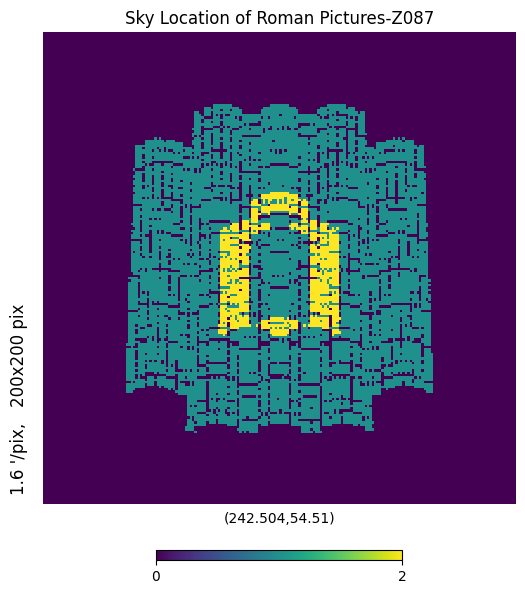

In [14]:
util.visualize_healpy(final_df, ra_cen, dec_cen)

In [15]:
final_df.shape

(810, 17)

In [16]:
current_mjd = int(Time.now().mjd)

In [17]:
current_mjd

60799

In [18]:
sim_file, pixel_data = util.sim_file_calc(final_df, ra_cen, dec_cen, current_mjd, total_degrees=6, step=5, rot="astropy")

SFD maps already present in ./dustmaps_data/sfd, skipping fetch.


In [19]:
print(sim_file)

DOCUMENTATION:
	PURPOSE: CCS SIMULATION
	USAGE_KEY: SIMLIB_FILE
	USAGE_CODE: snlc_sim.exe
DOCUMENTATION_END:
SURVEY: ROMAN
FILTERS: RZYJHF
PIXSIZE: 0.109
PSF_UNIT: NEA_PIXEL
SOLID_ANGLE: 662.616
TEXPOSE(WIDE): 60  86  96  153  293  0
TEXPOSE(DEEP): 0  194  294  307  419  1637
ZODI: 0.315  0.316  0.397  0.359  0.339  0.194
THERMAL: 0.003  0.003  0.003  0.003  0.048  0.155
BEGIN LIBGEN

LIBID: 0
RA: 239.626	DEC: 53.175
NOBS: 3
HEALPIX: 20087221	MWEBV:  0.011	PIXSIZE: 0.109
#   MJD    IDEXPT  BAND  GAIN  NOISE   SKYSIG  NEA     ZPTAVG  ZPTERR  MAG
S:  60799  1       R     1     12.87   4.368   5.575   31.064  0.005   99 
S:  60799  1       Z     1     11.233  5.238   6.695   31.139  0.005   99 
S:  60799  1       J     1     9.147   7.442   9.21    31.816  0.005   99 

LIBID: 1
RA: 239.654	DEC: 53.175
NOBS: 3
HEALPIX: 20087222	MWEBV:  0.011	PIXSIZE: 0.109
#   MJD    IDEXPT  BAND  GAIN  NOISE   SKYSIG  NEA     ZPTAVG  ZPTERR  MAG
S:  60799  1       R     1     12.87   4.368   5.575   31.06

In [20]:
with open("output_v2.txt", "w") as f:
    f.write(sim_file)

In [24]:
hp.nside2pixarea(4096, degrees = True)*60

np.float64(0.01229434050602295)

In [21]:
len(pixel_data)

53896

In [22]:
hp.nside2pixarea(4096, degrees = True)*60*len(pixel_data)

np.float64(662.6157759126129)